# Load the data

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
def reduce_mem_usage(df, verbose=True):
    numerics = ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']
    start_mem = df.memory_usage().sum() / 1024**2    
    for col in df.columns:
        col_type = df[col].dtypes
        if col_type in numerics:
            c_min = df[col].min()
            c_max = df[col].max()
            if str(col_type)[:3] == 'int':
                if c_min > np.iinfo(np.int8).min and c_max < np.iinfo(np.int8).max:
                    df[col] = df[col].astype(np.int8)
                elif c_min > np.iinfo(np.int16).min and c_max < np.iinfo(np.int16).max:
                    df[col] = df[col].astype(np.int16)
                elif c_min > np.iinfo(np.int32).min and c_max < np.iinfo(np.int32).max:
                    df[col] = df[col].astype(np.int32)
                elif c_min > np.iinfo(np.int64).min and c_max < np.iinfo(np.int64).max:
                    df[col] = df[col].astype(np.int64)  
            else:
                if c_min > np.finfo(np.float16).min and c_max < np.finfo(np.float16).max:
                    df[col] = df[col].astype(np.float16)
                elif c_min > np.finfo(np.float32).min and c_max < np.finfo(np.float32).max:
                    df[col] = df[col].astype(np.float32)
                else:
                    df[col] = df[col].astype(np.float64)    
    end_mem = df.memory_usage().sum() / 1024**2
    if verbose: print('Mem. usage decreased to {:5.2f} Mb ({:.1f}% reduction)'.format(end_mem, 100 * (start_mem - end_mem) / start_mem))
    return df

In [5]:
%%time
# Read the CSV files
#test_identity = reduce_mem_usage(pd.read_csv('data/test_identity.csv'))
#test_transaction = reduce_mem_usage(pd.read_csv('data/test_transaction.csv'))
train_identity = reduce_mem_usage(pd.read_csv('data/train_identity.csv'))
train_transaction = reduce_mem_usage(pd.read_csv('data/train_transaction.csv'))

Mem. usage decreased to 25.86 Mb (42.7% reduction)
Mem. usage decreased to 542.35 Mb (69.4% reduction)
Wall time: 3min 50s


# Visualize the data

In [6]:
train_identity.head()

,TransactionID,id_01,id_02,id_03,id_04,id_05,id_06,id_07,id_08,id_09,...,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38,DeviceType,DeviceInfo
0,2987004,0.0,70787.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,samsung browser 6.2,32.0,2220x1080,match_status:2,T,F,T,T,mobile,SAMSUNG SM-G892A Build/NRD90M
1,2987008,-5.0,98945.0,NaN,NaN,0.0,-5.0,NaN,NaN,NaN,...,mobile safari 11.0,32.0,1334x750,match_status:1,T,F,F,T,mobile,iOS Device
2,2987010,-5.0,191631.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,...,chrome 62.0,NaN,NaN,NaN,F,F,T,T,desktop,Windows
3,2987011,-5.0,221832.0,NaN,NaN,0.0,-6.0,NaN,NaN,NaN,...,chrome 62.0,NaN,NaN,NaN,F,F,T,T,desktop,NaN
4,2987016,0.0,7460.0,0.0,0.0,1.0,0.0,NaN,NaN,0.0,...,chrome 62.0,24.0,1280x800,match_status:2,T,F,T,T,desktop,MacOS


In [7]:
train_transaction.head()

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,...,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339
0,2987000,0,86400,68.5,W,13926,NaN,150.0,discover,142.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2987001,0,86401,29.0,W,2755,404.0,150.0,mastercard,102.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2987002,0,86469,59.0,W,4663,490.0,150.0,visa,166.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2987003,0,86499,50.0,W,18132,567.0,150.0,mastercard,117.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2987004,0,86506,50.0,H,4497,514.0,150.0,mastercard,102.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [8]:
print(train_transaction.shape)
print(train_identity.shape)
# print(test_transaction.shape)
# print(test_identity.shape)

(590540, 394)
(144233, 41)


# Merge the data frames based on the transaction column

In [9]:
train_df = train_transaction.merge(train_identity, on='TransactionID', how='left')

In [10]:
train_df.head()

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,...,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38,DeviceType,DeviceInfo
0,2987000,0,86400,68.5,W,13926,NaN,150.0,discover,142.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2987001,0,86401,29.0,W,2755,404.0,150.0,mastercard,102.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2987002,0,86469,59.0,W,4663,490.0,150.0,visa,166.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2987003,0,86499,50.0,W,18132,567.0,150.0,mastercard,117.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2987004,0,86506,50.0,H,4497,514.0,150.0,mastercard,102.0,...,samsung browser 6.2,32.0,2220x1080,match_status:2,T,F,T,T,mobile,SAMSUNG SM-G892A Build/NRD90M


# Data cleanup & visualization

## Identify column types and missing values

In [11]:
for column in train_df:
    col = train_df[column]
    print('{0} [{4}]: Count={1}, NaN={2}, NaN%={3}%'.format(
        column, 
        len(col), 
        len(col)-col.count(), 
        (len(col)-col.count())*100/len(col),
        col.dtype
    ))

TransactionID [int32]: Count=590540, NaN=0, NaN%=0.0%
isFraud [int8]: Count=590540, NaN=0, NaN%=0.0%
TransactionDT [int32]: Count=590540, NaN=0, NaN%=0.0%
TransactionAmt [float16]: Count=590540, NaN=0, NaN%=0.0%
ProductCD [object]: Count=590540, NaN=0, NaN%=0.0%
card1 [int16]: Count=590540, NaN=0, NaN%=0.0%
card2 [float16]: Count=590540, NaN=8933, NaN%=1.5126833068039423%
card3 [float16]: Count=590540, NaN=1565, NaN%=0.26501168422122123%
card4 [object]: Count=590540, NaN=1577, NaN%=0.267043722694483%
card5 [float16]: Count=590540, NaN=4259, NaN%=0.7212043214684865%
card6 [object]: Count=590540, NaN=1571, NaN%=0.26602770345785215%
addr1 [float16]: Count=590540, NaN=65706, NaN%=11.12642666034477%
addr2 [float16]: Count=590540, NaN=65706, NaN%=11.12642666034477%
dist1 [float16]: Count=590540, NaN=352271, NaN%=59.6523520845328%
dist2 [float16]: Count=590540, NaN=552913, NaN%=93.62837403054831%
P_emaildomain [object]: Count=590540, NaN=94456, NaN%=15.99485216920107%
R_emaildomain [object]: 

V117 [float16]: Count=590540, NaN=314, NaN%=0.053171673383682734%
V118 [float16]: Count=590540, NaN=314, NaN%=0.053171673383682734%
V119 [float16]: Count=590540, NaN=314, NaN%=0.053171673383682734%
V120 [float16]: Count=590540, NaN=314, NaN%=0.053171673383682734%
V121 [float16]: Count=590540, NaN=314, NaN%=0.053171673383682734%
V122 [float16]: Count=590540, NaN=314, NaN%=0.053171673383682734%
V123 [float16]: Count=590540, NaN=314, NaN%=0.053171673383682734%
V124 [float16]: Count=590540, NaN=314, NaN%=0.053171673383682734%
V125 [float16]: Count=590540, NaN=314, NaN%=0.053171673383682734%
V126 [float32]: Count=590540, NaN=314, NaN%=0.053171673383682734%
V127 [float32]: Count=590540, NaN=314, NaN%=0.053171673383682734%
V128 [float32]: Count=590540, NaN=314, NaN%=0.053171673383682734%
V129 [float16]: Count=590540, NaN=314, NaN%=0.053171673383682734%
V130 [float16]: Count=590540, NaN=314, NaN%=0.053171673383682734%
V131 [float16]: Count=590540, NaN=314, NaN%=0.053171673383682734%
V132 [floa

V281 [float16]: Count=590540, NaN=1269, NaN%=0.21488806854743117%
V282 [float16]: Count=590540, NaN=1269, NaN%=0.21488806854743117%
V283 [float16]: Count=590540, NaN=1269, NaN%=0.21488806854743117%
V284 [float16]: Count=590540, NaN=12, NaN%=0.0020320384732617604%
V285 [float16]: Count=590540, NaN=12, NaN%=0.0020320384732617604%
V286 [float16]: Count=590540, NaN=12, NaN%=0.0020320384732617604%
V287 [float16]: Count=590540, NaN=12, NaN%=0.0020320384732617604%
V288 [float16]: Count=590540, NaN=1269, NaN%=0.21488806854743117%
V289 [float16]: Count=590540, NaN=1269, NaN%=0.21488806854743117%
V290 [float16]: Count=590540, NaN=12, NaN%=0.0020320384732617604%
V291 [float16]: Count=590540, NaN=12, NaN%=0.0020320384732617604%
V292 [float16]: Count=590540, NaN=12, NaN%=0.0020320384732617604%
V293 [float16]: Count=590540, NaN=12, NaN%=0.0020320384732617604%
V294 [float16]: Count=590540, NaN=12, NaN%=0.0020320384732617604%
V295 [float16]: Count=590540, NaN=12, NaN%=0.0020320384732617604%
V296 [floa

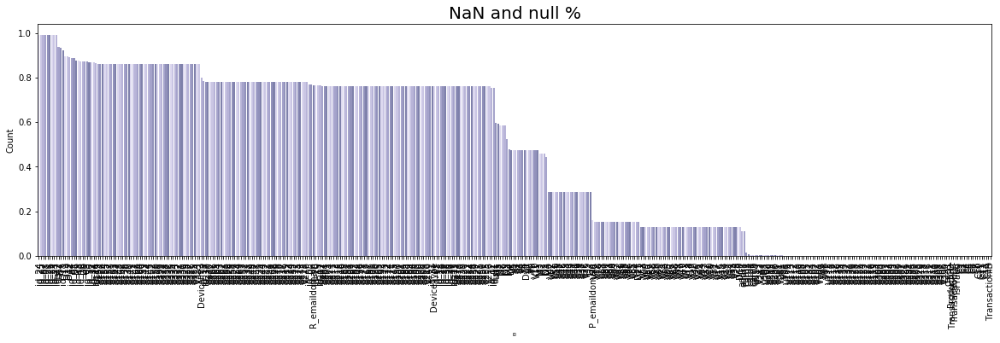

In [12]:
# visualize null values
plt.figure(figsize=(20,5))
plt.xlabel('ID', size=5)
plt.ylabel('Count', size=10)
plt.xticks(rotation='vertical')
plt.title("NaN and null %", size=20)
sns.barplot(y=train_df.isnull().sum().sort_values(ascending=False)/len(train_df),
        x=train_df.isnull().sum().sort_values(ascending=False).index,
        palette=sns.color_palette("ch:2.8,.1,dark=.5"))

Text(0, 0.5, 'Count')

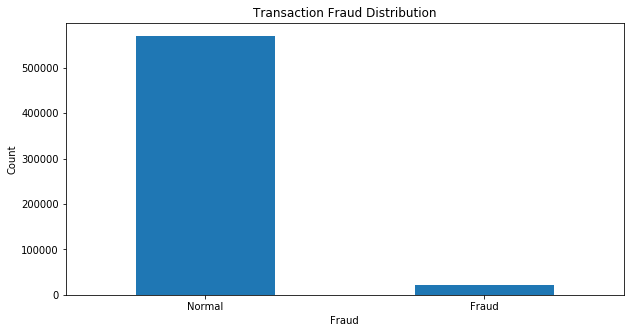

In [13]:
plt.figure(figsize=(10,5))
count_fraud = pd.value_counts(train_df["isFraud"], sort = True)
count_fraud.plot(kind='bar', rot=0)
plt.title("Transaction Fraud Distribution")
plt.xticks(range(2), ["Normal", "Fraud"])
plt.xlabel("Fraud")
plt.ylabel("Count")

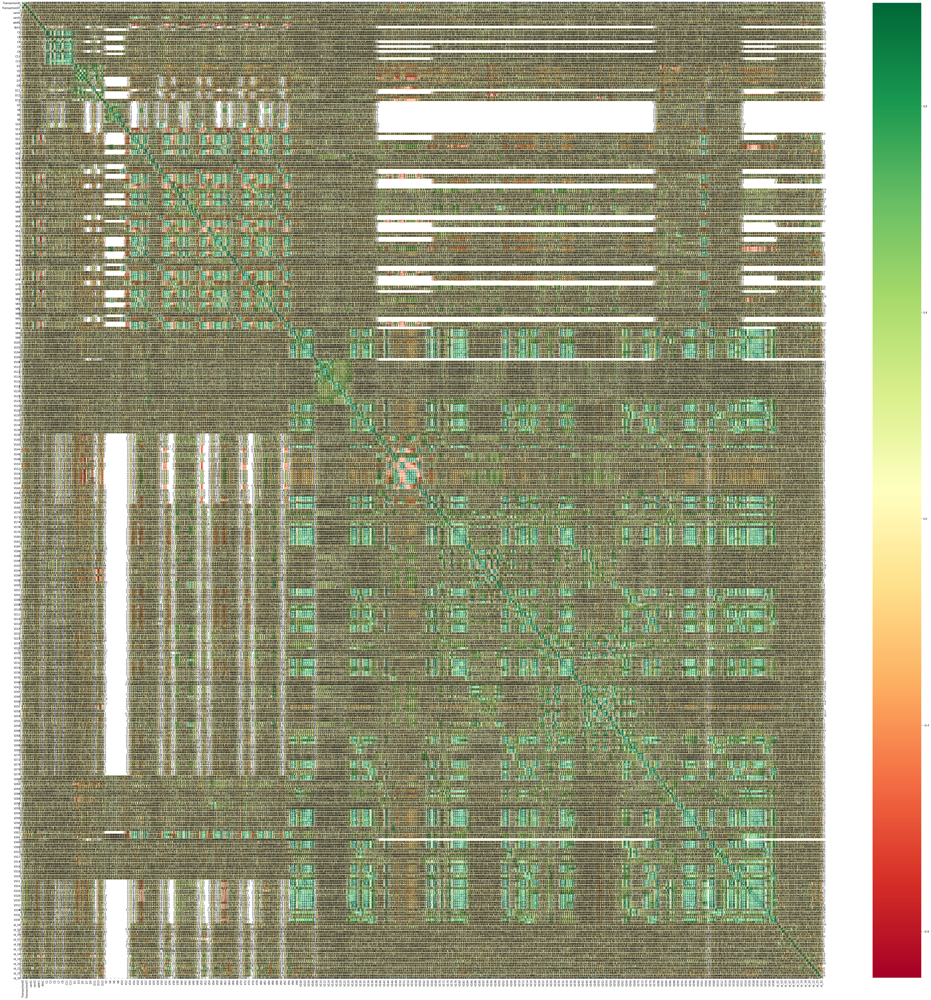

In [14]:
# get correlations of each feature in the dataset
corrmat = train_df.corr()
top_corr_features = corrmat.index
plt.figure(figsize=(70,70))
g = sns.heatmap(train_df[top_corr_features].corr(), annot=True, cmap="RdYlGn")

In [15]:
# get list of null values in ascending order
nan_arr = train_df.isnull().sum().sort_values(ascending=False)

In [16]:
# convert list of null values to a dataframe
nan_df = pd.DataFrame.from_dict(nan_arr, orient='columns')
nan_df.rename(columns={0:'count'}, inplace=True)
print(nan_df)

                count
id_24          585793
id_25          585408
id_07          585385
id_08          585385
id_21          585381
...               ...
C11                 0
C12                 0
C13                 0
C14                 0
TransactionID       0

[434 rows x 1 columns]


In [17]:
# get a list of the top 30% of null value columns to delete
nan_df = nan_df[nan_df.iloc[:,0] > len(train_df)*.7]
nan_df.head(1000)

,count
id_24,585793
id_25,585408
id_07,585385
id_08,585385
id_21,585381
...,...
V251,449124
V255,449124
V256,449124
id_12,446307


In [18]:
# Drop columns in train data set matching column names in nan_df2
train_df = train_df.drop(nan_df.index, axis='columns')

In [19]:
train_df.shape

(590540, 226)

In [ ]:
# another unused approach
# df1 = train_df.loc[:, train_df.isnull().mean() <= .5]
# print (df1)

## Fill NaN with 'undefined' for all object columns

In [20]:
# fill undefined for NaN objects
for col in train_df:
    if train_df[col].dtype == 'object':
        print(col)
        train_df[col] = train_df[col].fillna('undefined')
        
train_df.to_csv('data/train_df_undef')

ProductCD
card4
card6
P_emaildomain
M1
M2
M3
M4
M5
M6
M7
M8
M9


## Remove rows with mostly NaN values as they won't add much info to our model

In [24]:
print(train_df.count(1))
print(9*train_df.shape[1]/10)

2         223
5         223
6         223
9         226
18        223
         ... 
590533    226
590536    222
590537    222
590538    226
590539    224
Length: 254676, dtype: int64
203.4


In [25]:
# get some statistics on the number of NaN per row
# df2 = train_df.loc[train_df.count(1) > train_df.shape[1]/2, df.count(0) > df.shape[0]/2]
train_df = train_df.loc[train_df.count(1) > 9*train_df.shape[1]/10]
train_df.shape


(254676, 226)

In [26]:
train_df.to_csv('data/train_truncated_NaN')

## Fill NaN with median

In [51]:
train_df = reduce_mem_usage(pd.read_csv('data/train_truncated_NaN'))

object_cols = train_df[train_df.select_dtypes(include=['object']).columns].columns.values
numeric_cols = train_df[train_df.select_dtypes(exclude=['object']).columns].columns.values
print(object_cols)
print(numeric_cols)

Mem. usage decreased to 131.88 Mb (70.1% reduction)
['ProductCD' 'card4' 'card6' 'P_emaildomain' 'M1' 'M2' 'M3' 'M4' 'M5' 'M6'
 'M7' 'M8' 'M9']
['Unnamed: 0' 'TransactionID' 'isFraud' 'TransactionDT' 'TransactionAmt'
 'card1' 'card2' 'card3' 'card5' 'addr1' 'addr2' 'dist1' 'C1' 'C2' 'C3'
 'C4' 'C5' 'C6' 'C7' 'C8' 'C9' 'C10' 'C11' 'C12' 'C13' 'C14' 'D1' 'D2'
 'D3' 'D4' 'D5' 'D10' 'D11' 'D15' 'V1' 'V2' 'V3' 'V4' 'V5' 'V6' 'V7' 'V8'
 'V9' 'V10' 'V11' 'V12' 'V13' 'V14' 'V15' 'V16' 'V17' 'V18' 'V19' 'V20'
 'V21' 'V22' 'V23' 'V24' 'V25' 'V26' 'V27' 'V28' 'V29' 'V30' 'V31' 'V32'
 'V33' 'V34' 'V35' 'V36' 'V37' 'V38' 'V39' 'V40' 'V41' 'V42' 'V43' 'V44'
 'V45' 'V46' 'V47' 'V48' 'V49' 'V50' 'V51' 'V52' 'V53' 'V54' 'V55' 'V56'
 'V57' 'V58' 'V59' 'V60' 'V61' 'V62' 'V63' 'V64' 'V65' 'V66' 'V67' 'V68'
 'V69' 'V70' 'V71' 'V72' 'V73' 'V74' 'V75' 'V76' 'V77' 'V78' 'V79' 'V80'
 'V81' 'V82' 'V83' 'V84' 'V85' 'V86' 'V87' 'V88' 'V89' 'V90' 'V91' 'V92'
 'V93' 'V94' 'V95' 'V96' 'V97' 'V98' 'V99' 'V100' 'V101'

In [52]:
#train_df.set_index('TransactionID', inplace=True)

for col in numeric_cols:
    arr = train_df[train_df[col]!=np.nan][col]
    train_df[col].replace(np.nan, arr.median(), inplace=True)

#########################
# Other approaches tried
#########################

# just chews up memory and if I try to print the resulting dataframe I get some weird recurssion error
#for col in train_df:
#    print(col)
#    train_df[col].fillna(train_df[col].median, inplace=True)

# the algorithm in sklearn for imputing NaNs seems to work much better and memory drops back after completion compared to the fillna method of dataframes
#from sklearn.impute import SimpleImputer
#imp_median = SimpleImputer(missing_values=np.nan, strategy='median')
#train_df = imp_median.fit_transform(train_df)

In [53]:
train_df

,Unnamed: 0,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,...,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321
0,2,2987002,0,86469,59.000000,W,4663,490.0,150.0,visa,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,5,2987005,0,86510,49.000000,W,5937,555.0,150.0,visa,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,6,2987006,0,86522,159.000000,W,12308,360.0,150.0,visa,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,9,2987009,0,86536,117.000000,W,17399,111.0,150.0,mastercard,...,0.0,0.0,495.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,18,2987018,0,86725,47.937500,W,4663,490.0,150.0,visa,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
254671,590533,3577533,0,15811029,107.937500,W,13071,321.0,150.0,visa,...,210.0,210.0,210.0,210.0,0.0,0.0,0.0,0.0,0.0,0.0
254672,590536,3577536,0,15811049,39.500000,W,10444,225.0,150.0,mastercard,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
254673,590537,3577537,0,15811079,30.953125,W,12037,595.0,150.0,mastercard,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
254674,590538,3577538,0,15811088,117.000000,W,7826,481.0,150.0,mastercard,...,117.0,317.5,669.5,317.5,0.0,2234.0,0.0,0.0,0.0,0.0


In [54]:
# clear memory consumed due to expensive operations above
import gc
gc.collect()

# get percentage of fraudulent transactions
len(train_df[train_df["isFraud"]==1])/len(train_df)*100

1.9251912233583062

In [55]:
# The date and time of a transaction migh be relevant but I chose to remove it from the data for this exercise for simplicity
train_df = train_df.drop(["TransactionDT"], axis='columns')
train_df

,Unnamed: 0,TransactionID,isFraud,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,...,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321
0,2,2987002,0,59.000000,W,4663,490.0,150.0,visa,166.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,5,2987005,0,49.000000,W,5937,555.0,150.0,visa,226.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,6,2987006,0,159.000000,W,12308,360.0,150.0,visa,166.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,9,2987009,0,117.000000,W,17399,111.0,150.0,mastercard,224.0,...,0.0,0.0,495.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,18,2987018,0,47.937500,W,4663,490.0,150.0,visa,166.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
254671,590533,3577533,0,107.937500,W,13071,321.0,150.0,visa,226.0,...,210.0,210.0,210.0,210.0,0.0,0.0,0.0,0.0,0.0,0.0
254672,590536,3577536,0,39.500000,W,10444,225.0,150.0,mastercard,224.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
254673,590537,3577537,0,30.953125,W,12037,595.0,150.0,mastercard,224.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
254674,590538,3577538,0,117.000000,W,7826,481.0,150.0,mastercard,224.0,...,117.0,317.5,669.5,317.5,0.0,2234.0,0.0,0.0,0.0,0.0


In [56]:
# set x and y variables
y_df = train_df[["TransactionID","isFraud"]]
x_df = train_df.drop(["isFraud"], axis='columns')

In [57]:
y_df.set_index("TransactionID", inplace=True)
y_df

,isFraud
TransactionID,
2987002,0
2987005,0
2987006,0
2987009,0
2987018,0
...,...
3577533,0
3577536,0
3577537,0


In [58]:
x_df.set_index("TransactionID", inplace=True)
x_df

,Unnamed: 0,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,addr1,...,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321
TransactionID,,,,,,,,,,,,,,,,,,,,,
2987002,2,59.000000,W,4663,490.0,150.0,visa,166.0,debit,330.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2987005,5,49.000000,W,5937,555.0,150.0,visa,226.0,debit,272.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2987006,6,159.000000,W,12308,360.0,150.0,visa,166.0,debit,126.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2987009,9,117.000000,W,17399,111.0,150.0,mastercard,224.0,debit,204.0,...,0.0,0.0,495.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2987018,18,47.937500,W,4663,490.0,150.0,visa,166.0,debit,184.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3577533,590533,107.937500,W,13071,321.0,150.0,visa,226.0,debit,485.0,...,210.0,210.0,210.0,210.0,0.0,0.0,0.0,0.0,0.0,0.0
3577536,590536,39.500000,W,10444,225.0,150.0,mastercard,224.0,debit,204.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3577537,590537,30.953125,W,12037,595.0,150.0,mastercard,224.0,debit,231.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [59]:
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn_pandas import DataFrameMapper

# mapper not working with df_out=True !!!!! not sure why
mapper = DataFrameMapper([(x_df[x_df.select_dtypes(exclude=['object']).columns].columns, StandardScaler()), 
                          #(x_df[x_df.select_dtypes(include=['object']).columns].columns, OneHotEncoder())
                         ], df_out=False)
cols = x_df.select_dtypes(exclude=['object']).columns.tolist() # + x_df.select_dtypes(include=['object']).columns.tolist()
scaled_features = mapper.fit_transform(x_df[cols].copy())
scaled_features_df = pd.DataFrame(scaled_features, columns=cols, index=x_df[cols].index)


In [60]:
scaled_features_df.head()

,Unnamed: 0,TransactionAmt,card1,card2,card3,card5,addr1,addr2,dist1,C1,...,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321
TransactionID,,,,,,,,,,,,,,,,,,,,,
2987002,-2.228562,-0.349159,-1.079681,0.889305,0.008248,-0.913210,0.399330,0.008752,0.595066,-0.272435,...,-0.288315,-0.240291,-0.272788,-0.249415,-0.073394,-0.128805,-0.102403,-0.094594,-0.132531,-0.109007
2987005,-2.228543,-0.383986,-0.817306,1.310458,0.008248,0.601436,-0.171446,0.008752,-0.170107,-0.272435,...,-0.288315,-0.240291,-0.272788,-0.249415,-0.073394,-0.128805,-0.102403,-0.094594,-0.132531,-0.109007
2987006,-2.228536,-0.000889,0.494774,0.047001,0.008248,-0.913210,-1.608225,0.008752,-0.279853,-0.272435,...,-0.288315,-0.240291,-0.272788,-0.249415,-0.073394,-0.128805,-0.102403,-0.094594,-0.132531,-0.109007
2987009,-2.228517,-0.147162,1.543244,-1.566337,0.008248,0.550948,-0.840631,0.008752,-0.221932,-0.237869,...,-0.288315,-0.240291,2.249561,-0.249415,-0.073394,-0.128805,-0.102403,-0.094594,-0.132531,-0.109007
2987018,-2.228460,-0.387687,-1.079681,0.889305,0.008248,-0.913210,-1.037450,0.008752,-0.264611,-0.272435,...,-0.288315,-0.240291,-0.272788,-0.249415,-0.073394,-0.128805,-0.102403,-0.094594,-0.132531,-0.109007


## Change objects to numbers

In [61]:
#use one-hot encoding for categorical data
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer, make_column_transformer

# will only OneHotEncode a few columns (doning this for all categorical columsn will result in overfitting and a huge matrix of 590540 x 2113 which kills my computer)
# preprocess = make_column_transformer((OneHotEncoder(),['card4', 'card6', 'DeviceType']))
preprocess = make_column_transformer((OneHotEncoder(), object_cols))

In [62]:
# transform one hot encoding
transformed_categories = preprocess.fit_transform(x_df[object_cols].copy())

In [63]:
transformed_categories_df = pd.DataFrame(transformed_categories.todense(), index=x_df.index)
transformed_categories_df.head()

,0,1,2,3,4,5,6,7,8,9,...,81,82,83,84,85,86,87,88,89,90
TransactionID,,,,,,,,,,,,,,,,,,,,,
2987002,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
2987005,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0
2987006,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
2987009,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0
2987018,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0


In [64]:
# drop columns that were OneHotEncoded
x_df = x_df.drop(object_cols, axis='columns')

In [66]:
# insert OneHotEncoded columns
x_df = x_df.merge(transformed_categories_df, on='TransactionID', how='left')

In [67]:
#check if all columns are now numeric
print(x_df.shape)
print(x_df._get_numeric_data().shape)

(254676, 302)
(254676, 302)


In [68]:
x_df.to_csv('data/x_df')
y_df.to_csv('data/y_df')

In [ ]:
x_df = reduce_mem_usage(pd.read_csv('data/x_df'))
y_df = reduce_mem_usage(pd.read_csv('data/y_df'))

# Model and Predict

In [70]:
from sklearn.model_selection import train_test_split

# split the data into train and test
X_train, X_test, y_train, y_test = train_test_split(x_df, y_df, test_size=0.3)

In [94]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import recall_score
from sklearn.metrics import accuracy_score

In [73]:
lr = LogisticRegression(solver='lbfgs')
lr.fit(X_train, y_train)

# Another approach
# use local outlier algorithm to handle the imbalanced data set
# isolation forest algorithm

m:\partnerships\scbureau\training\make money with machine learning\assignments\venv\lib\site-packages\sklearn\utils\validation.py:724: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
m:\partnerships\scbureau\training\make money with machine learning\assignments\venv\lib\site-packages\sklearn\linear_model\logistic.py:947: ConvergenceWarning: lbfgs failed to converge. Increase the number of iterations.
  "of iterations.", ConvergenceWarning)


LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=100,
                   multi_class='warn', n_jobs=None, penalty='l2',
                   random_state=None, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)

In [74]:
lr.score(X_test, y_test)

0.9807075638391163

In [82]:
y_pred = lr.predict(X_test)
y_pred = pd.DataFrame(y_pred, columns=['isFraud'], index=y_test.index)

In [83]:
y_pred

,isFraud
TransactionID,
3038732,0
3386234,0
3411573,0
3150666,0
3436878,0
...,...
3024541,0
3408173,0
3520630,0


In [84]:
y_test

,isFraud
TransactionID,
3038732,0
3386234,0
3411573,0
3150666,0
3436878,0
...,...
3024541,0
3408173,0
3520630,0


In [92]:
pd.crosstab(y_test['isFraud'].values, y_pred['isFraud'].values, rownames=['True'], colnames=['Predicted'], margins=True)

Predicted,0,1,All
True,,,
0,74920,17,74937
1,1457,9,1466
All,76377,26,76403


In [96]:
accuracy_score(y_test, y_pred)

0.9807075638391163

In [97]:
recall_score(y_test, y_pred)

0.006139154160982265